<a href="https://colab.research.google.com/github/Fermu25/Cursos/blob/main/CD_clase_11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Clase 11

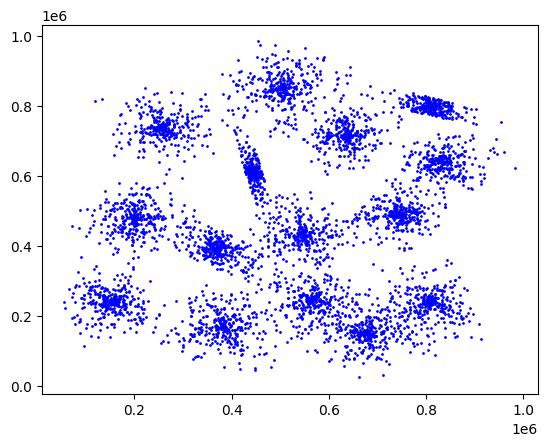

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
data = pd.read_csv("gauss.csv", names=["x", "y"])
plt.scatter(data["x"], data["y"], s=1, color="blue")

https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html

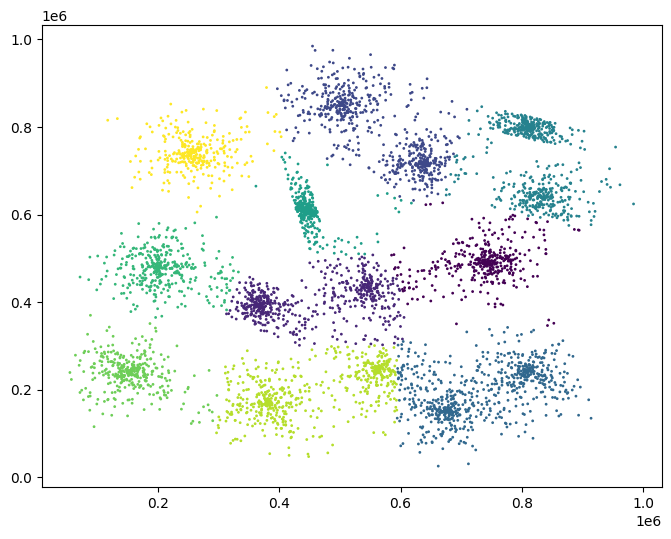

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10, random_state=1234)
labels = kmeans.fit_predict(data)#como los arboles de decisión
plt.figure(figsize=(8, 6))
plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="viridis")

https://matplotlib.org/stable/gallery/color/named_colors.html

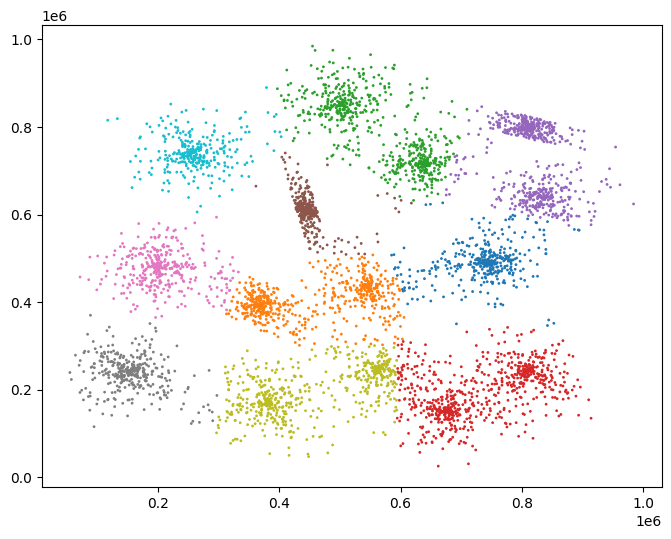

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10, random_state=1234)
labels = kmeans.fit_predict(data)#como los arboles de decisión
plt.figure(figsize=(8, 6))
plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="tab10")#colores uniforme para comparación cualitativa

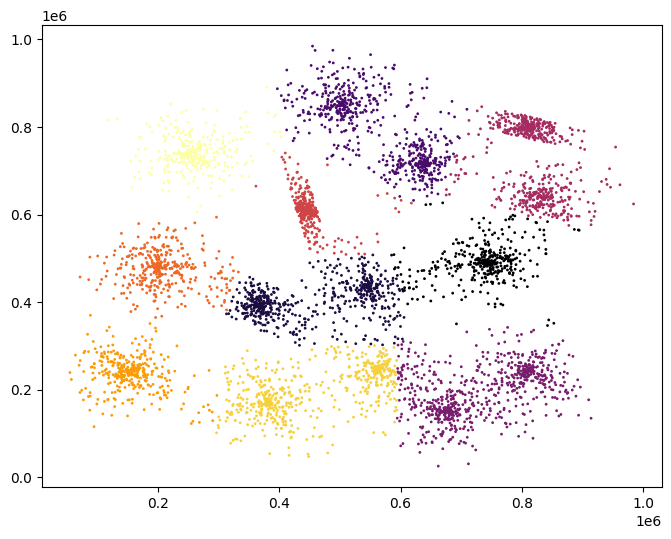

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10, random_state=1234)
labels = kmeans.fit_predict(data)#como los arboles de decisión
plt.figure(figsize=(8, 6))
plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="inferno")

¿puedes evaluar si el clustering con k = 10 fue exitoso?

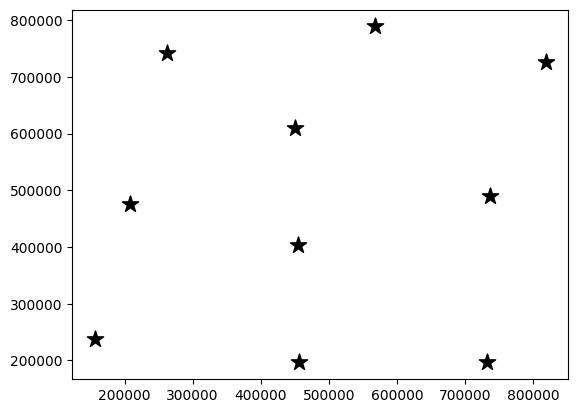

In [ ]:
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], marker="*", color="black", s=150)

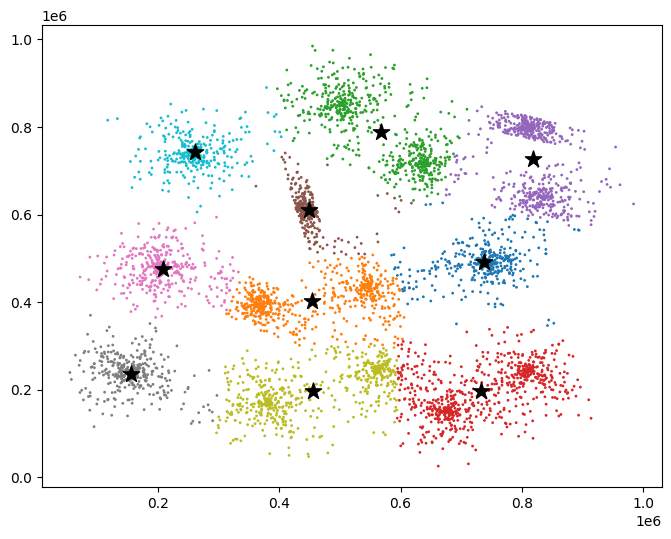

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10, random_state=1234)
labels = kmeans.fit_predict(data)#como los arboles de decisión
plt.figure(figsize=(8, 6))
plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="tab10")
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], marker="*", color="black", s=150)

Realiza una iteración para valores de k desde 2 hasta 20, aplicando el algoritmo k-means con cada valor de k.

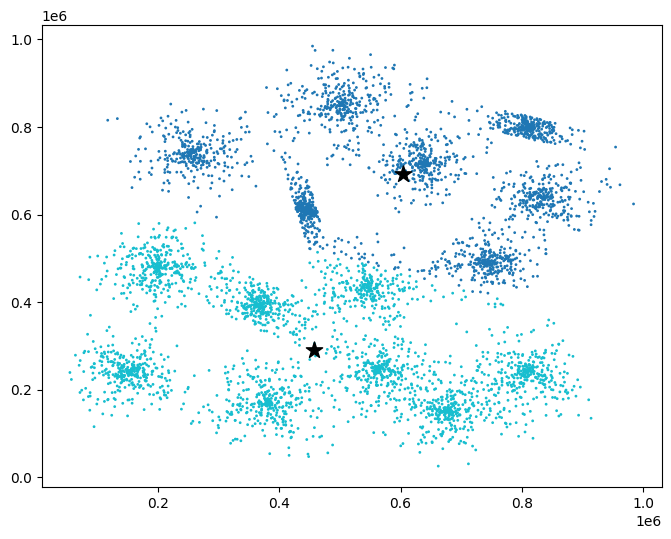

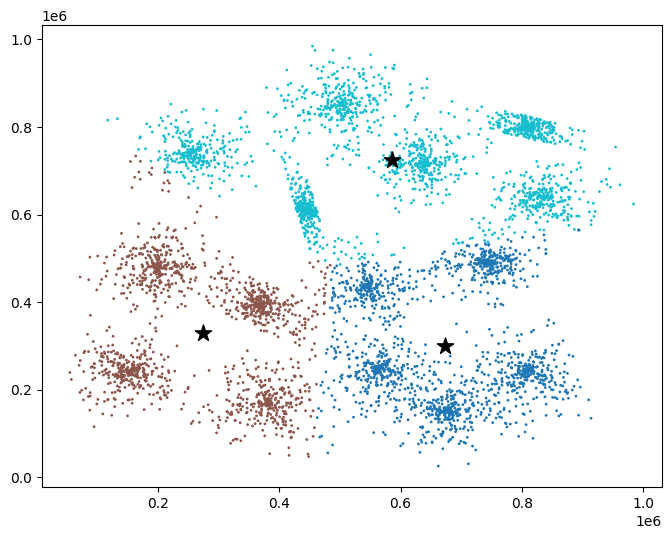

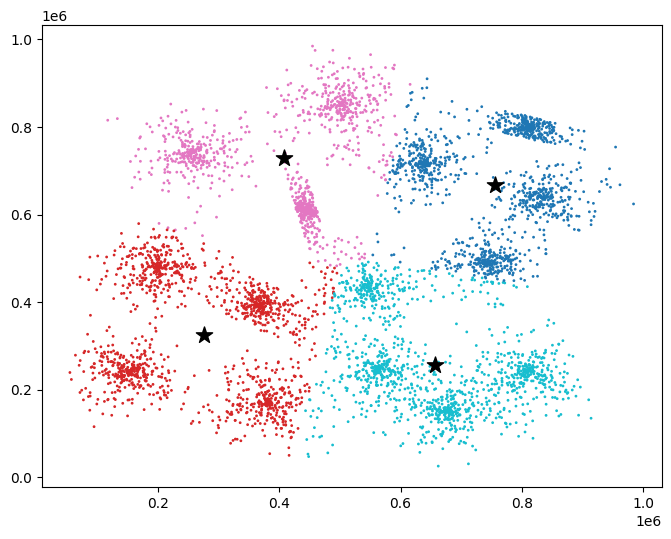

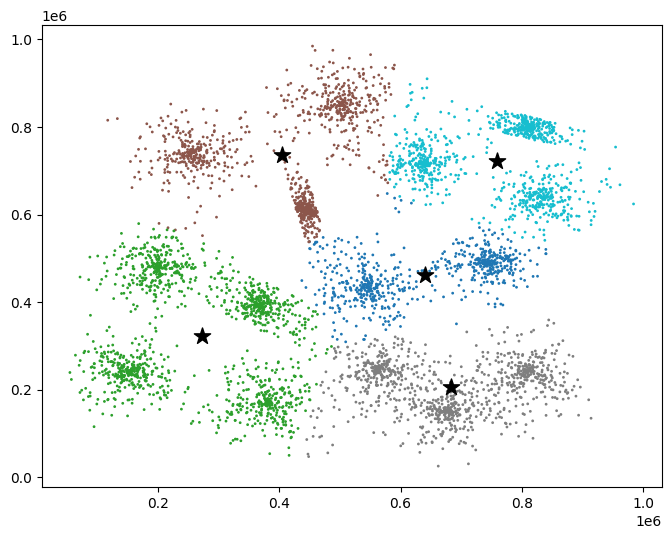

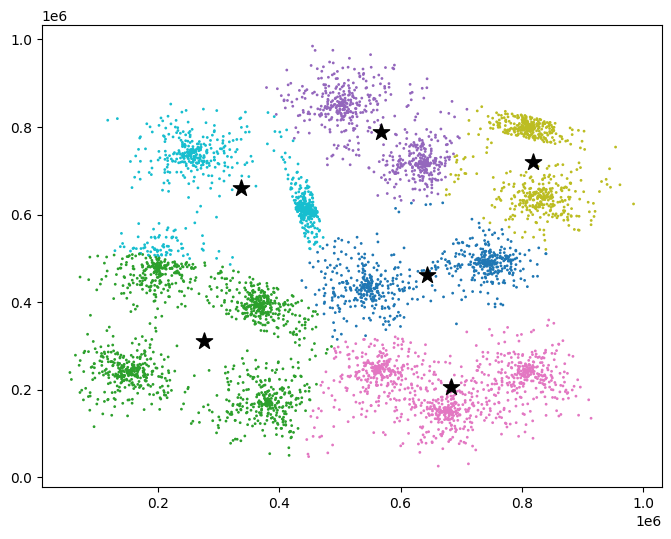

...

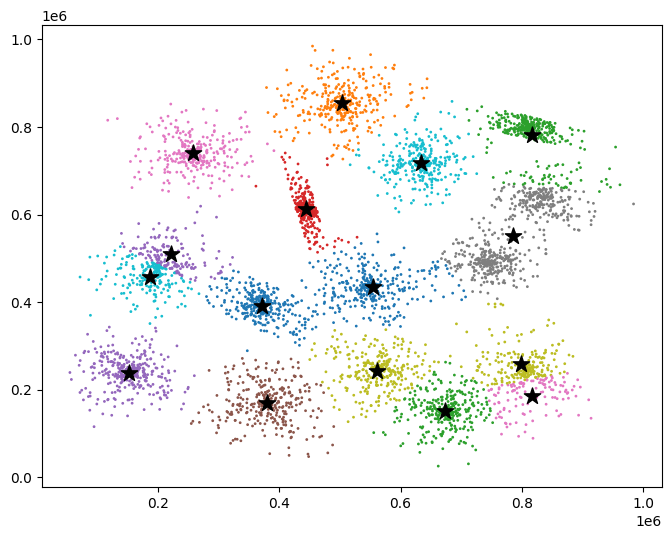

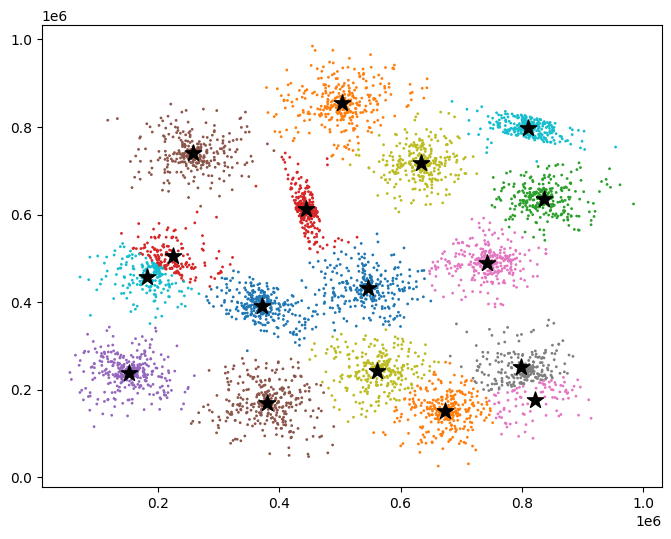

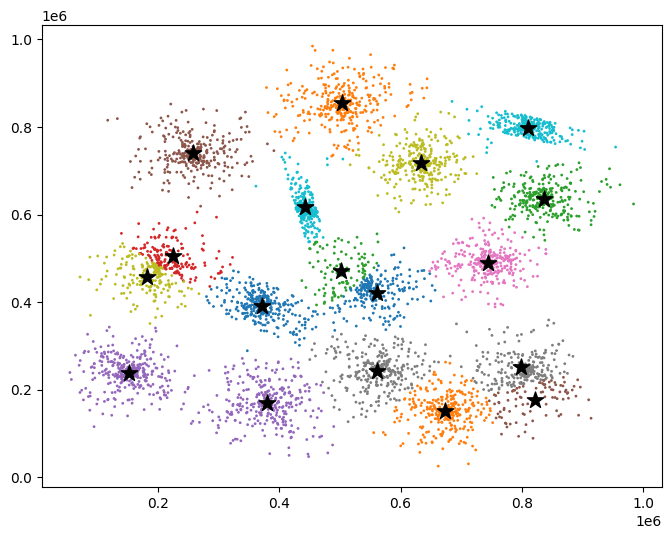

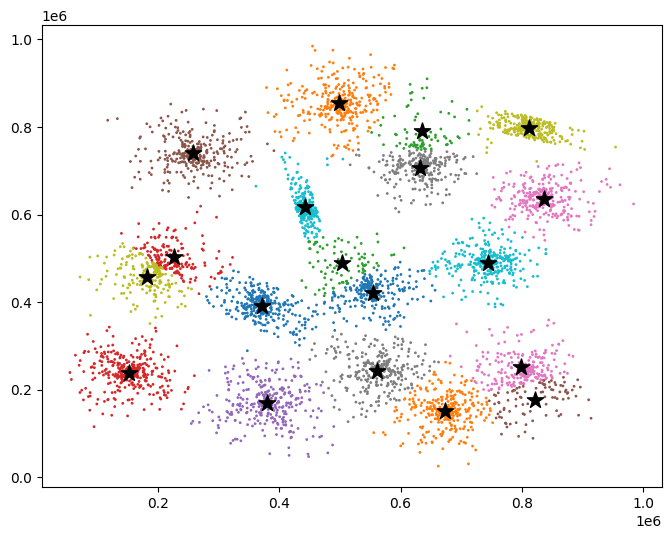

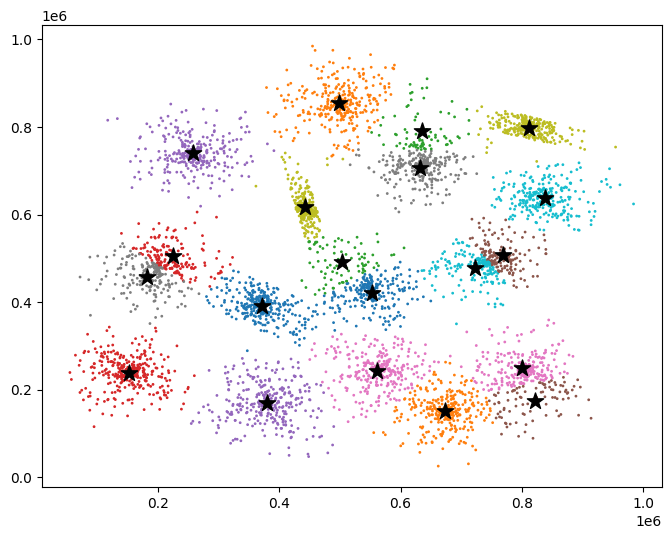

In [ ]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

kmeans_results = {}
for k in range(2, 21):
  kmeans = KMeans(n_clusters=k, random_state=1234)
  labels = kmeans.fit_predict(data)
  plt.figure(figsize=(8, 6))
  plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="tab10")
  centroids = kmeans.cluster_centers_
  plt.scatter(centroids[:, 0], centroids[:, 1], marker="*", color="black", s=150)

  kmeans_results[k] = {
      'labels': labels,
      'centroids': centroids
    }

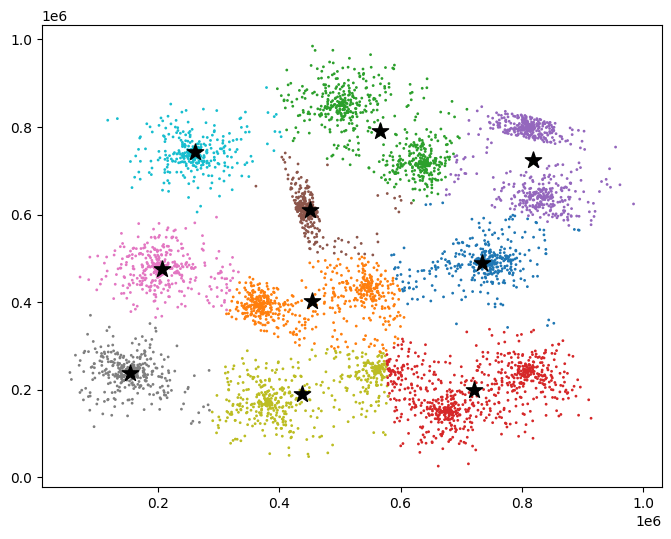

In [ ]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

kmeans_results = {}
kmeans = KMeans(n_clusters=10, random_state=1234, max_iter=10)#max_iter=10
labels = kmeans.fit_predict(data)
plt.figure(figsize=(8, 6))
plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="tab10")
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], marker="*", color="black", s=150)

https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.clf.html

In [ ]:
Hacer un gif terando sobre max_itere

In [ ]:
import os
import matplotlib.pyplot as plt
import imageio
from sklearn.cluster import KMeans

plot_dir = "kmeans_plots"

if not os.path.exists(plot_dir):
    os.makedirs(plot_dir)

kmeans_results = {}

for k in range(2, 21):
    kmeans = KMeans(n_clusters=k, random_state=1234, n_init=10)
    labels = kmeans.fit_predict(data)
    centroids = kmeans.cluster_centers_

    kmeans_results[k] = {
        'labels': labels,
        'centroids': centroids
    }


    plt.figure(figsize=(8, 6))
    plt.scatter(data["x"], data["y"], c=labels, s=1, cmap="tab10")
    plt.scatter(centroids[:, 0], centroids[:, 1], marker="*", color="black", s=150)
    plt.title(f"K-Means Clustering with k={k}")
    plt.savefig(f"{plot_dir}/kmeans_k_{k}.png")
    plt.close()

image_files = [os.path.join(plot_dir, f) for f in os.listdir(plot_dir) if f.endswith('.png')]
image_files.sort(key=lambda x: int(os.path.basename(x).split('_')[-1].split('.')[0]))

images = []
for file_name in image_files:
    images.append(imageio.imread(file_name))

imageio.mimsave('kmeans_animation.gif', images, duration=500) # duration in milliseconds

/tmp/ipython-input-1669411683.py:36: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(file_name))


# Conjunto de datos chameleon

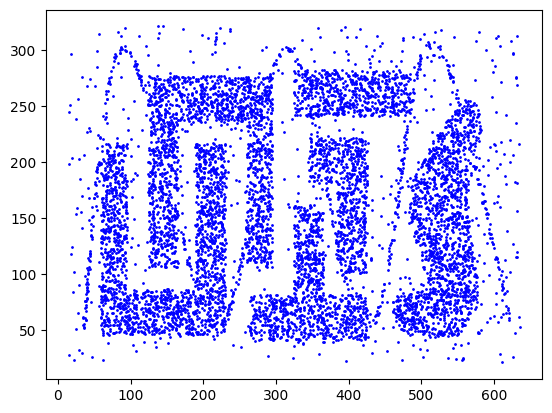

In [ ]:
data = pd.read_csv("chameleon.csv", names=["x", "y"])
plt.scatter(data["x"], data["y"], s=1, color="blue")
#conjunto con ruido, pero no para el cluster

/tmp/ipython-input-1438293431.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))


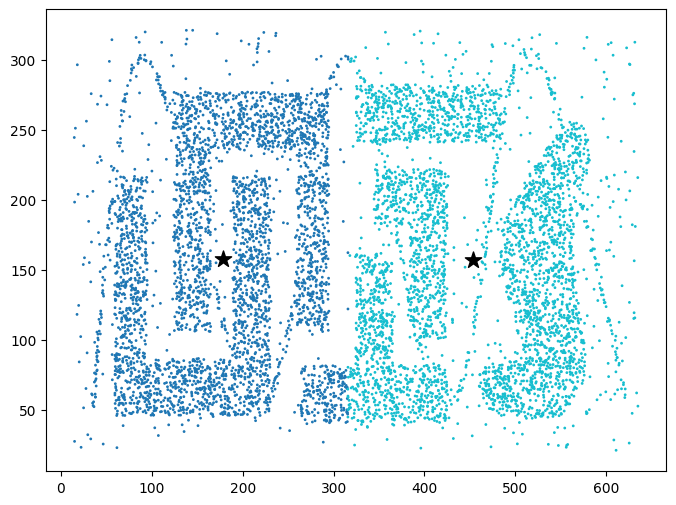

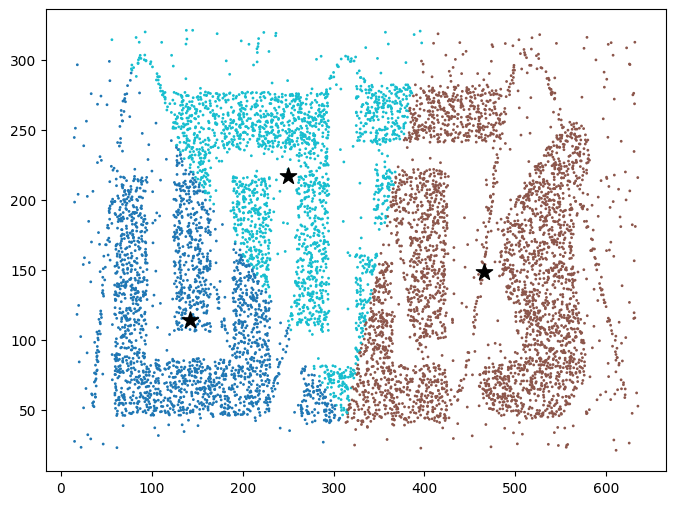

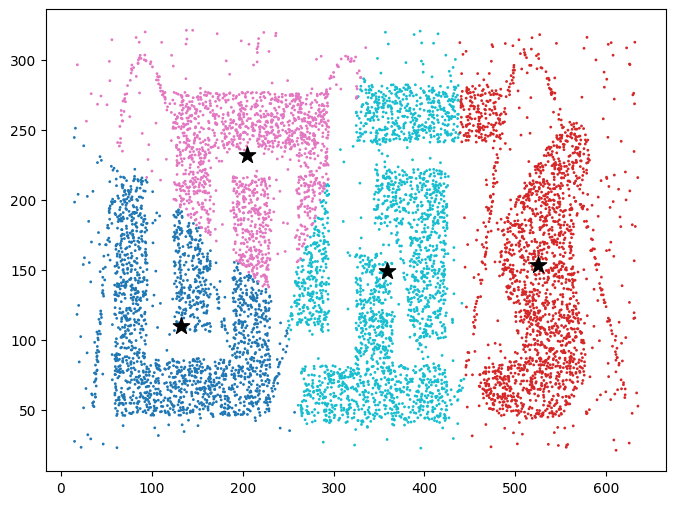

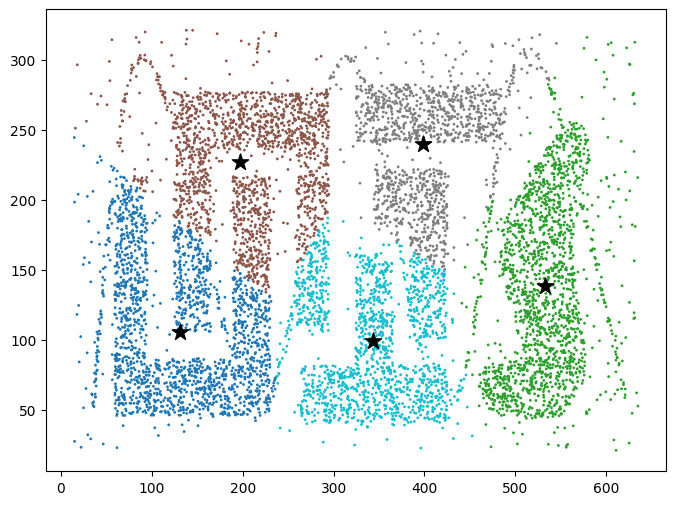

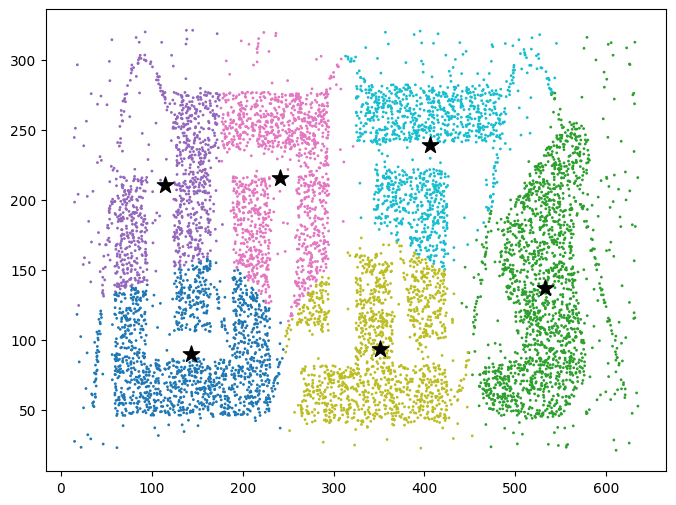

...

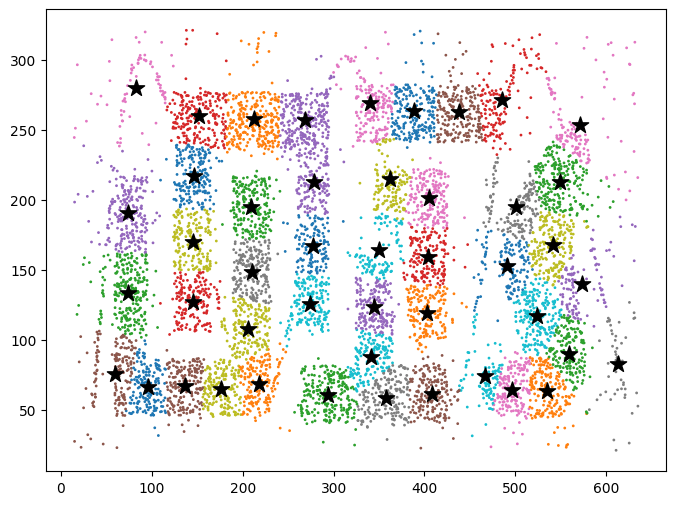

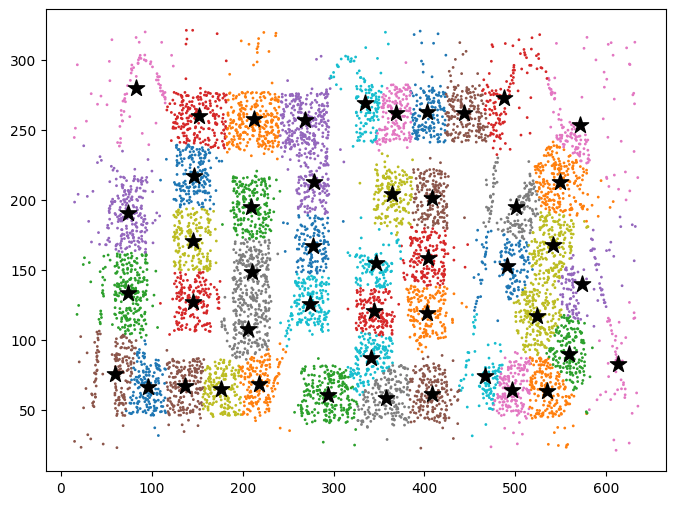

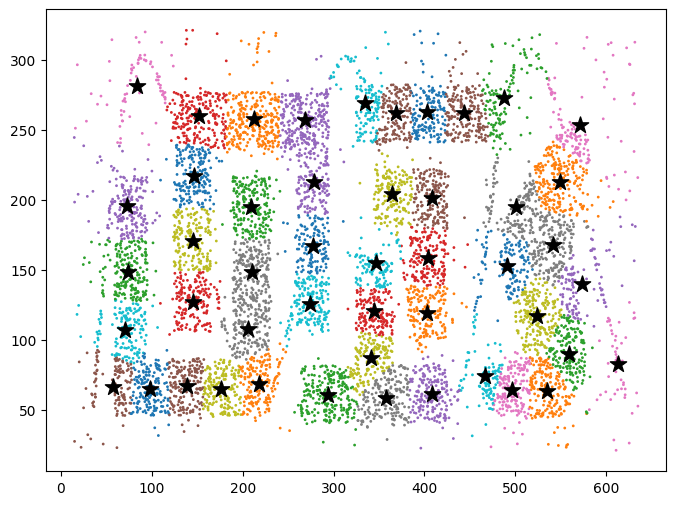

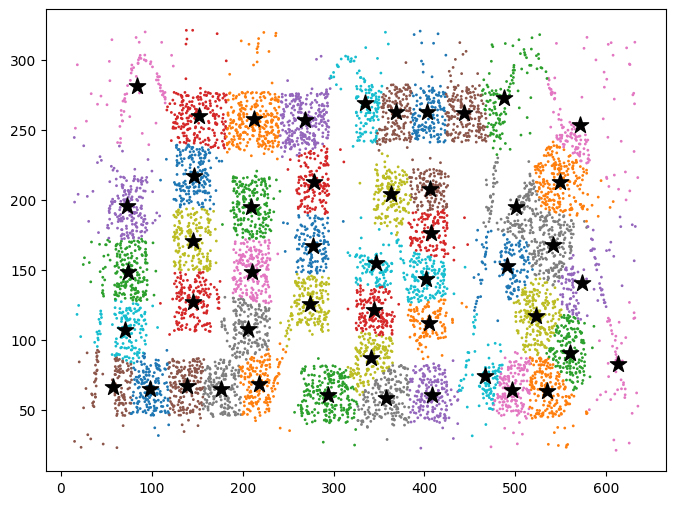

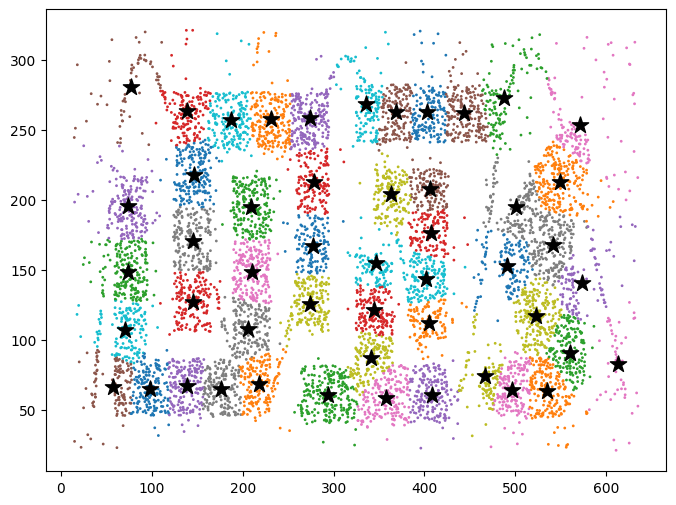

In [ ]:
kmeans_results = {}
for k in range(2, 51):
  kmeans = KMeans(n_clusters=k, random_state=1234,max_iter=10)
  labels = kmeans.fit_predict(data)
  plt.figure(figsize=(8, 6))
  plt.scatter(data["x"], data["y"], c=labels,s=1, cmap="tab10")
  centroids = kmeans.cluster_centers_
  plt.scatter(centroids[:, 0], centroids[:, 1], marker="*", color="black", s=150)

  kmeans_results[k] = {
      'labels': labels,
      'centroids': centroids
    }

# Algoritmo DBSCAN

https://www.naftaliharris.com/blog/visualizing-dbscan-clustering/

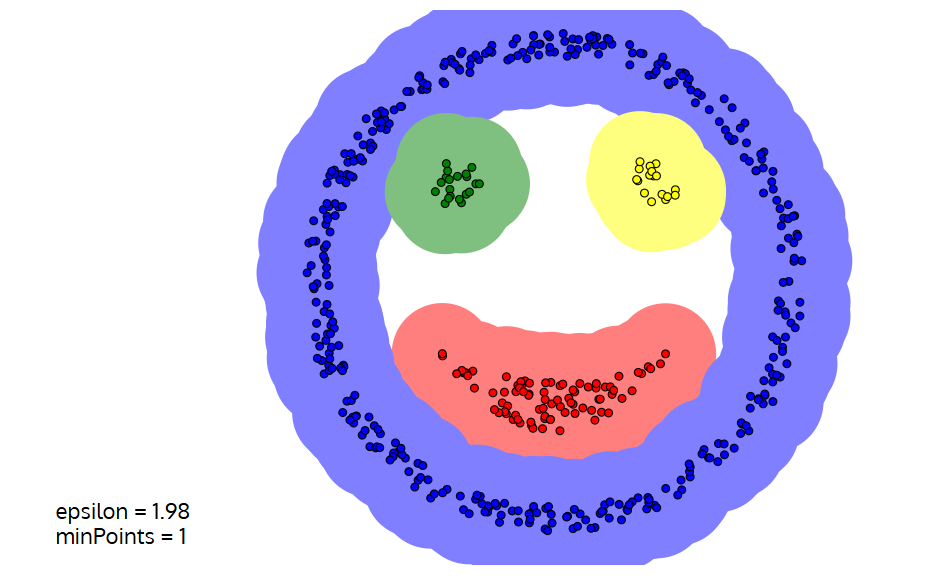

Ahora introducimos ruido, ahora puede dejar puntos fuera que son ruido
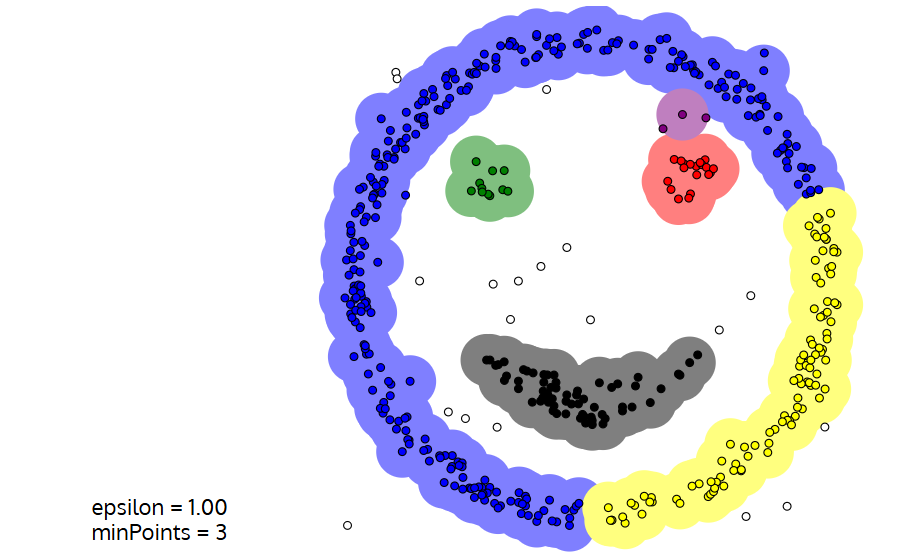


https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html

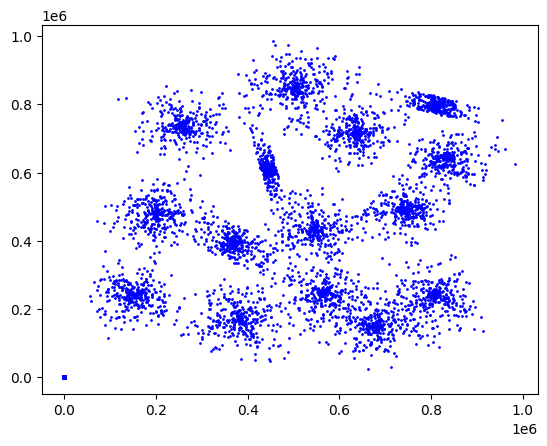

In [ ]:
data = pd.read_csv("gauss.csv", names=["x", "y"])
plt.scatter(data["x"], data["y"], s=1, color="blue")
#Clusters irregulares
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)
df = pd.DataFrame(data_scaled, columns=["x", "y"])
plt.scatter(df["x"], df["y"], s=5, color="blue")


15


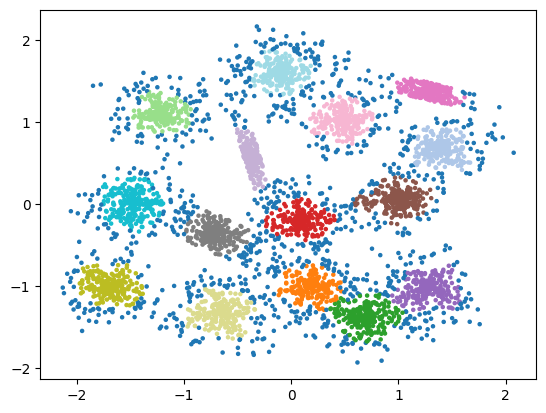

In [ ]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.1, min_samples=20)
labels = dbscan.fit_predict(df)
plt.scatter(data_scaled[:, 0], data_scaled[:, 1], c=labels, cmap="tab20", s=5)#Escalar, solo modificar el eje, no tener datos del 1 a 1e6 sino solo de 1 a 2

n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(n_clusters)

Resolver el cluster, los clusters hallarlos, aislar ruido

3


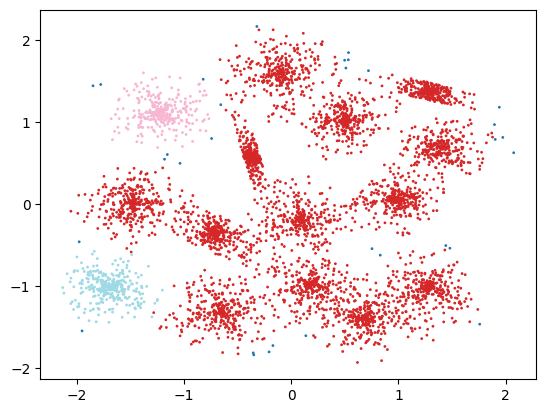

In [ ]:
#drawforce y jala,
#Tenemos 5000 puntos, 13 circulos
#R aprox. 0.5, alrededor de 300 puntos por circulo para resolver
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.2, min_samples=20)
labels = dbscan.fit_predict(df)
plt.scatter(data_scaled[:, 0], data_scaled[:, 1], c=labels, cmap="tab20", s=1)#Escalar, solo modificar el eje, no tener datos del 1 a 1e6 sino solo de 1 a 2

n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(n_clusters)

In [ ]:
#Para la tarea usar el vecino mas cercano, NearestNeighbors y ordenar por
#Encontrar lo que hay y quitarlo para ver la función detrás